In [14]:
import json
import random
import colorsys
from PIL import Image
import matplotlib.pyplot as plt
from matplotlib import patches,  lines
import numpy as np
import IPython.display

In [21]:
# based on https://github.com/matterport/Mask_RCNN/blob/master/mrcnn/visualize.py
def random_colors(N, bright=True):
    """
    Generate random colors.
    To get visually distinct colors, generate them in HSV space then
    convert to RGB.
    """
    brightness = 1.0 if bright else 0.7
    hsv = [(i / N, 1, brightness) for i in range(N)]
    colors = list(map(lambda c: colorsys.hsv_to_rgb(*c), hsv))
    random.shuffle(colors)
    return colors

def display_instances(image, boxes,
                      figsize=(16, 16), ax=None):
    """
    boxes: [num_instance, (y1, x1, y2, x2, class_id)] in image coordinates.
    figsize: (optional) the size of the image
    colors: (optional) An array or colors to use with each object
    """
    # Number of instances
    N = len(boxes)
    # print(boxes)
    print('Number of boxes: ', N)
    if not N:
        print("\n*** No instances to display *** \n")

    # If no axis is passed, create one and automatically call show()
    auto_show = False
    if not ax:
        _, ax = plt.subplots(1, figsize=figsize)
        auto_show = True

    # Generate random colors
    colors = random_colors(N)

    # Show area outside image boundaries.
    height, width  = image.shape[:2]
    ax.set_ylim(height + 10, -10)
    ax.set_xlim(-10, width + 10)
    ax.axis('off')
    
    for i in range(N):
        # if boxes[i][4] == 'person':
        color = colors[i]

        # Bounding box
        x1, y1, x2, y2 = boxes[i][:4]
        w, h = x2 - x1, y2 - y1
        print(w, h)
        p = patches.Rectangle((x1, y1), w, h, linewidth=2,
                            alpha=0.7, linestyle="dashed",
                            edgecolor=color, facecolor='none')
        ax.add_patch(p)

        # Label
        label = boxes[i][4]
        ax.text(x1, y1 + 8, label, color='w', size=15, backgroundcolor="none")

    ax.imshow(image)
    if auto_show:
        plt.show()
    print("image height=%d, width=%d" % (height, width))

In [25]:
# infos = json.load(open('/home/engineering/Documents/Thesis/Scene-Graph-Benchmark.pytorch/output/Saved_models/pre-rcnn_backbone=Resnet101/inference/AG_v3Graph_test/visual_info.json'))
infos = json.load(open('/home/engineering/Documents/Thesis/Scene-Graph-Benchmark.pytorch/output/res101/inference/AG_v3Graph_test/visual_info.json'))

gt
Number of boxes:  3
127.44844055175781 56.75627899169922 310.7669372558594 264.3409423828125
233.13690185546875 128.40475463867188 327.63690185546875 269.0
1.0 169.5 448.9988708496094 269.0


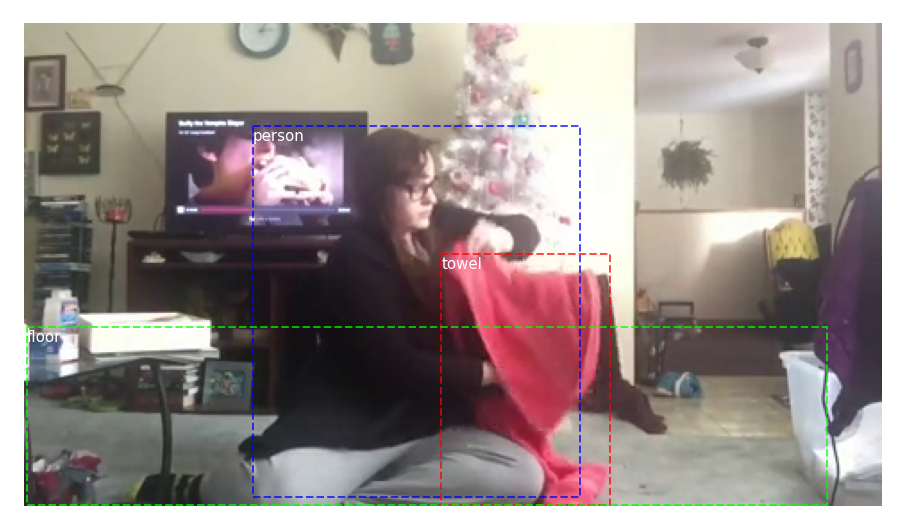

image height=270, width=480
predictions
Number of boxes:  257
0.0 111.5625 0.88818359375 110.5625
0.75048828125 193.0 0.0 192.0
0.0 96.125 0.87841796875 95.125
0.0 109.25 0.76611328125 108.25
0.0 112.8125 1.0068359375 114.5625
0.0 152.25 0.396728515625 185.25
0.0 94.6875 0.916015625 93.6875
0.0 141.375 1.494140625 249.875
0.0 96.3125 0.8720703125 95.3125
0.75048828125 193.0 0.0 192.0
164.25 268.75 163.25 268.25
184.75 268.75 183.75 268.25
424.0 268.75 423.0 268.25
0.0 168.0 1.3486328125 167.0
0.0 54.6875 1.0869140625 53.6875
0.0 204.125 3.23828125 203.125
0.0 247.0 0.2646484375 246.0
0.0 153.5 0.269287109375 152.5
0.0 206.875 4.07421875 205.875
0.0 203.125 3.080078125 202.125
0.0 162.0 0.50927734375 161.0
0.0 77.1875 0.794921875 76.1875
0.0 166.5 1.267578125 165.5
0.0 107.0 0.74560546875 109.375
0.0 247.375 0.307861328125 246.375
0.0 155.5 0.2261962890625 154.5
0.0 54.625 1.083984375 53.625
0.0 203.375 3.1171875 202.375
0.0 240.0 0.2093505859375 239.0
0.56640625 197.75 0.0 257.0
0.0 24

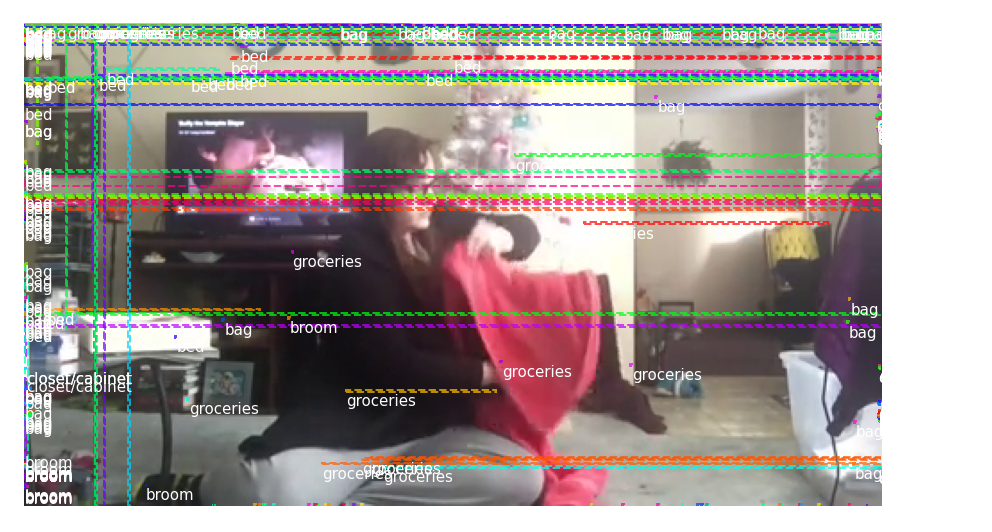

image height=270, width=480


In [26]:
for i, info in enumerate(infos):
    image = Image.open(info['img_file']).convert("RGB")
    image = np.asarray(image, np.uint8)
    print('gt'); display_instances(image, info['groundtruth'])
    print('predictions'); display_instances(image, info['prediction'])
    break

In [11]:
print(infos[0])

{'img_file': '/media/engineering/Millenium Falcon/Thesis/ActionGenome/dataset/ag/frames/MLWB5.mp4/000714.png', 'groundtruth': [[127.44844055175781, 56.75627899169922, 310.7669372558594, 264.3409423828125, 'person'], [233.13690185546875, 128.40475463867188, 327.63690185546875, 269.0, 'towel'], [1.0, 169.5, 448.9988708496094, 269.0, 'floor']], 'prediction': [[0.0, 111.5625, 0.88818359375, 110.5625, 'bag'], [0.75048828125, 193.0, 0.0, 192.0, 'closet/cabinet'], [0.0, 96.125, 0.87841796875, 95.125, 'bag'], [0.0, 109.25, 0.76611328125, 108.25, 'bag'], [0.0, 112.8125, 1.0068359375, 114.5625, 'bag'], [0.0, 152.25, 0.396728515625, 185.25, 'bag'], [0.0, 94.6875, 0.916015625, 93.6875, 'bag'], [0.0, 141.375, 1.494140625, 249.875, 'bag'], [0.0, 96.3125, 0.8720703125, 95.3125, 'bag'], [0.75048828125, 193.0, 0.0, 192.0, 'closet/cabinet'], [164.25, 268.75, 163.25, 268.25, 'bag'], [184.75, 268.75, 183.75, 268.25, 'bag'], [424.0, 268.75, 423.0, 268.25, 'bag'], [0.0, 168.0, 1.3486328125, 167.0, 'bag'], [

gt
Number of boxes:  4


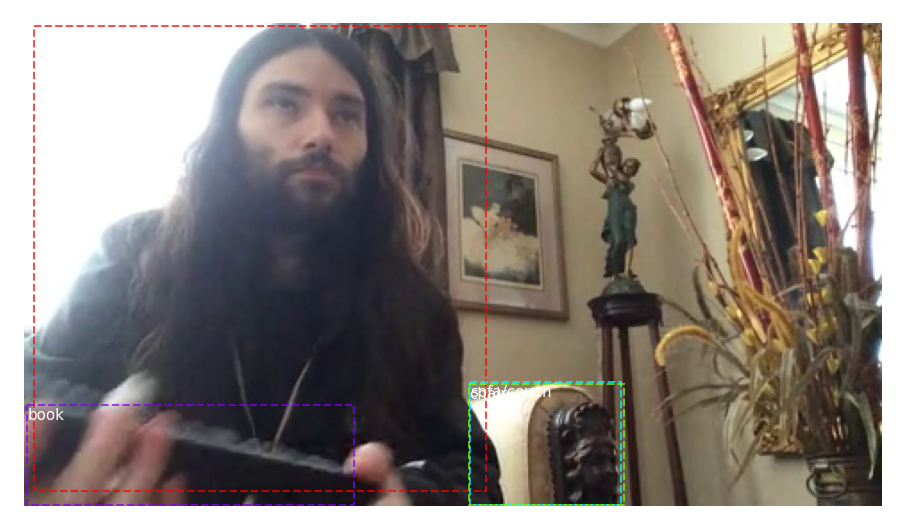

image height=270, width=480
predictions
Number of boxes:  312


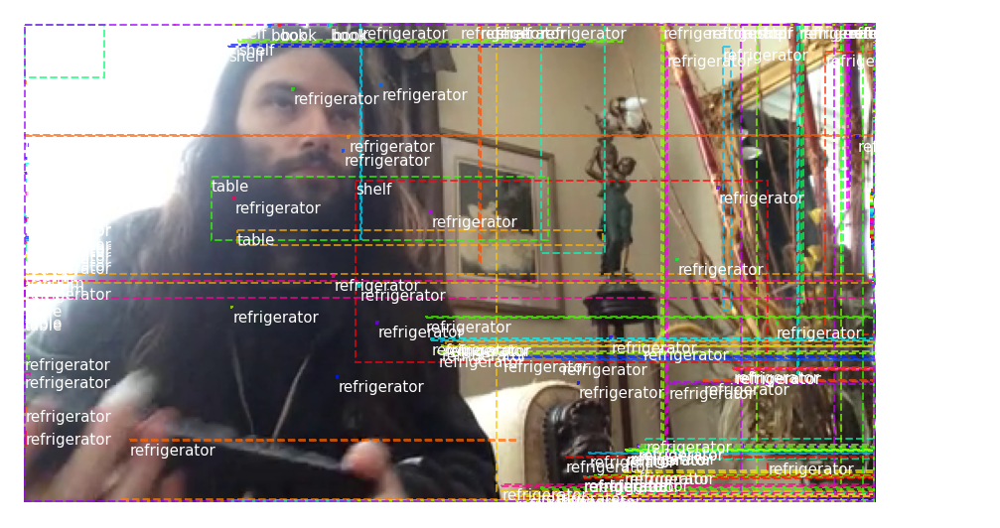

image height=270, width=480
gt
Number of boxes:  4


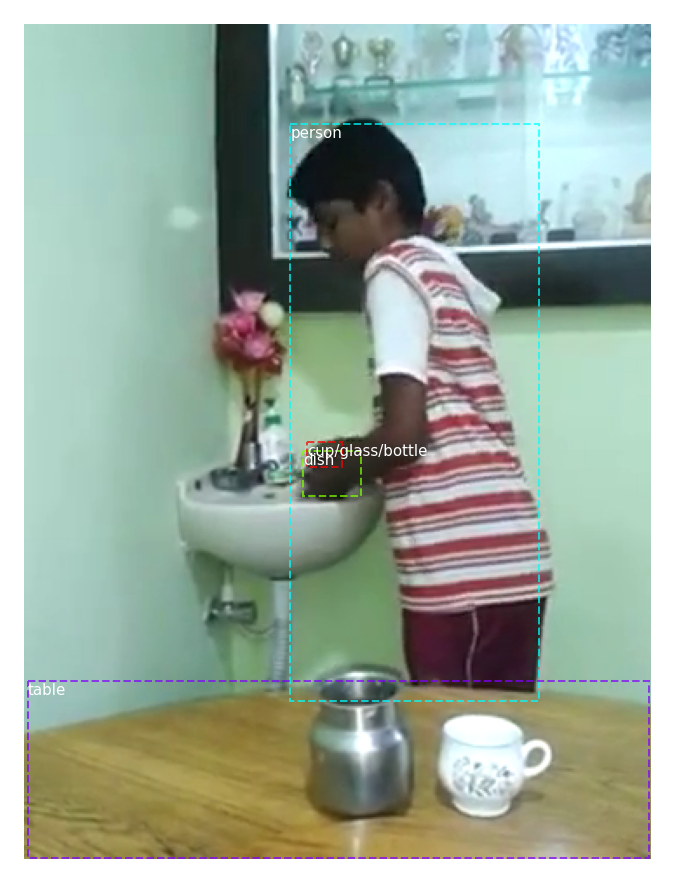

image height=480, width=360
predictions
Number of boxes:  396


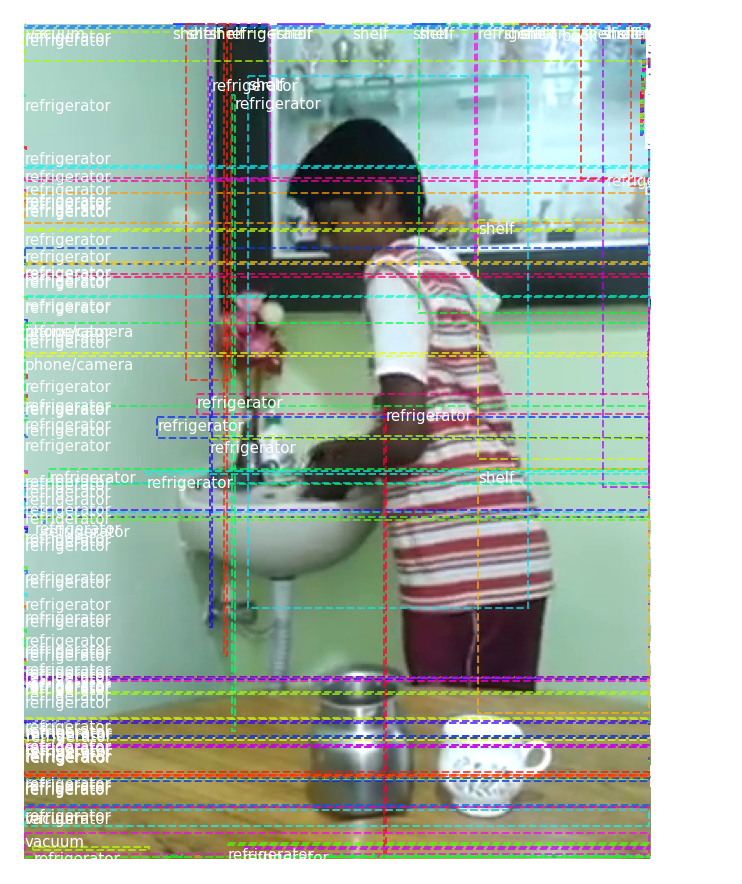

image height=480, width=360
gt
Number of boxes:  3


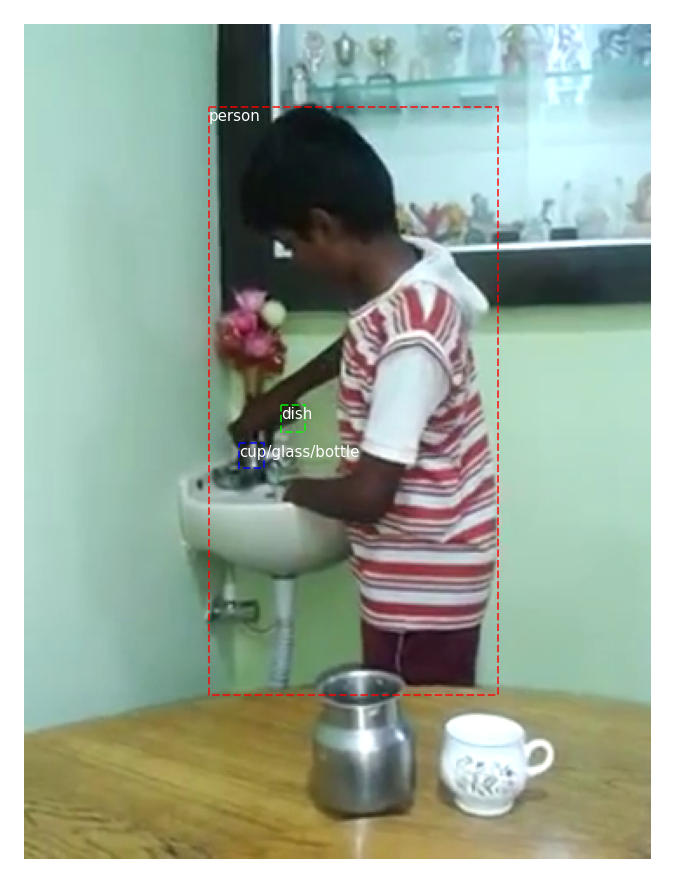

image height=480, width=360
predictions
Number of boxes:  336


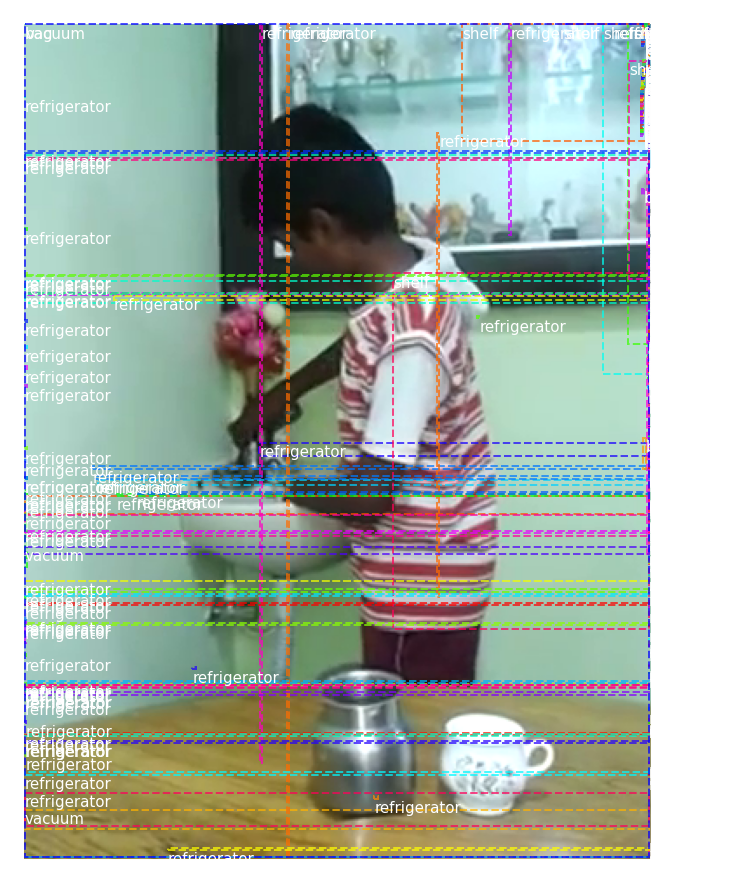

image height=480, width=360
gt
Number of boxes:  4


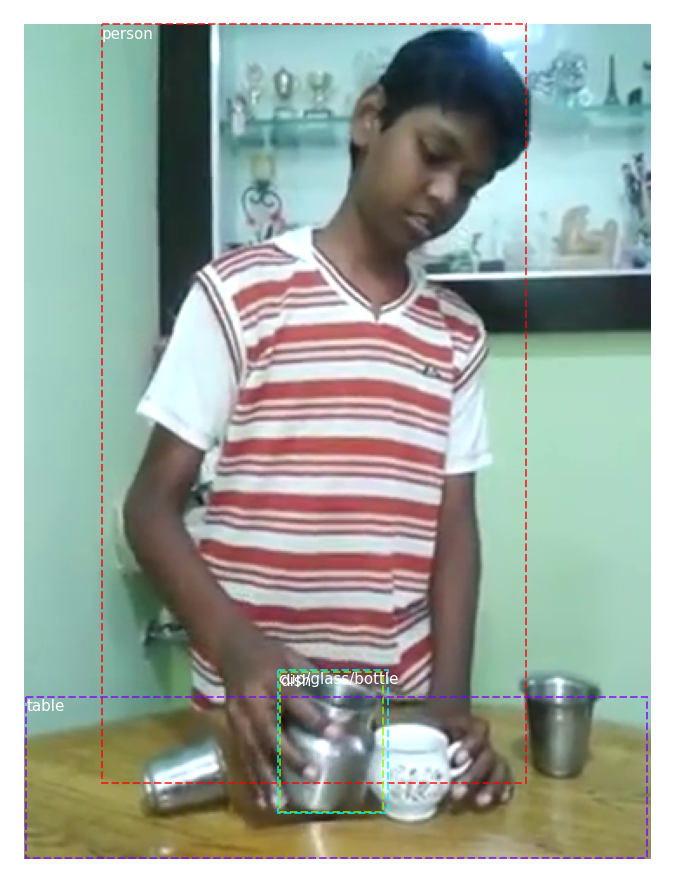

image height=480, width=360
predictions
Number of boxes:  288


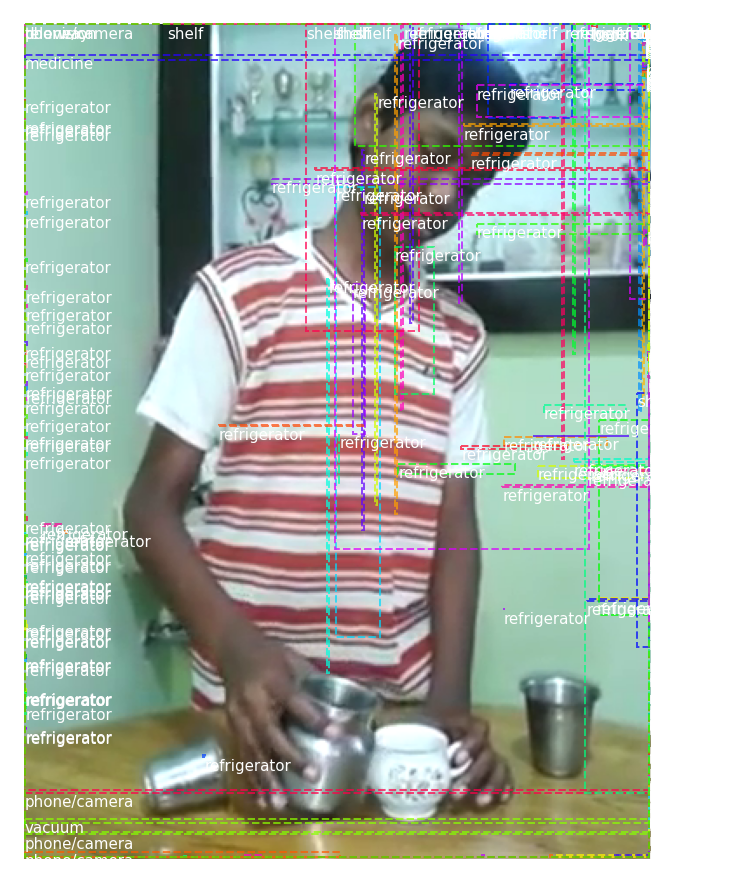

image height=480, width=360
gt
Number of boxes:  4


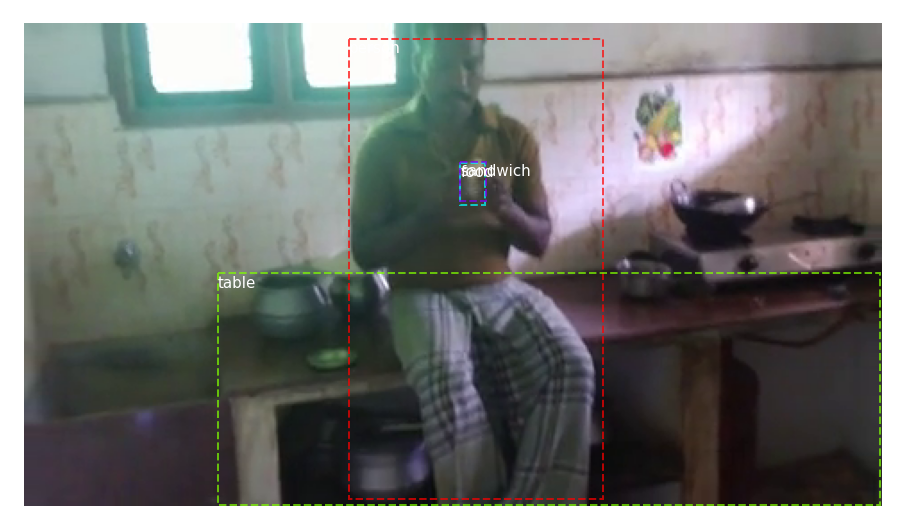

image height=270, width=480
predictions
Number of boxes:  256


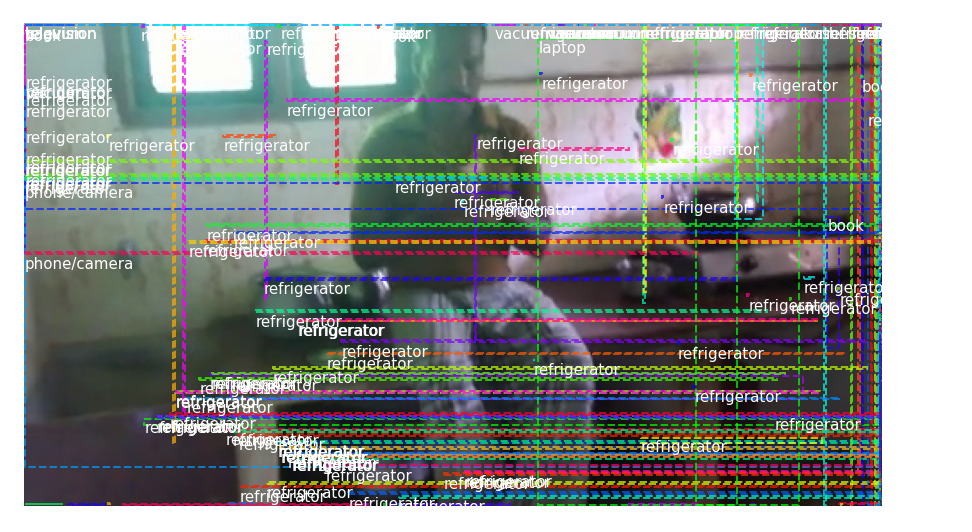

image height=270, width=480
gt
Number of boxes:  4


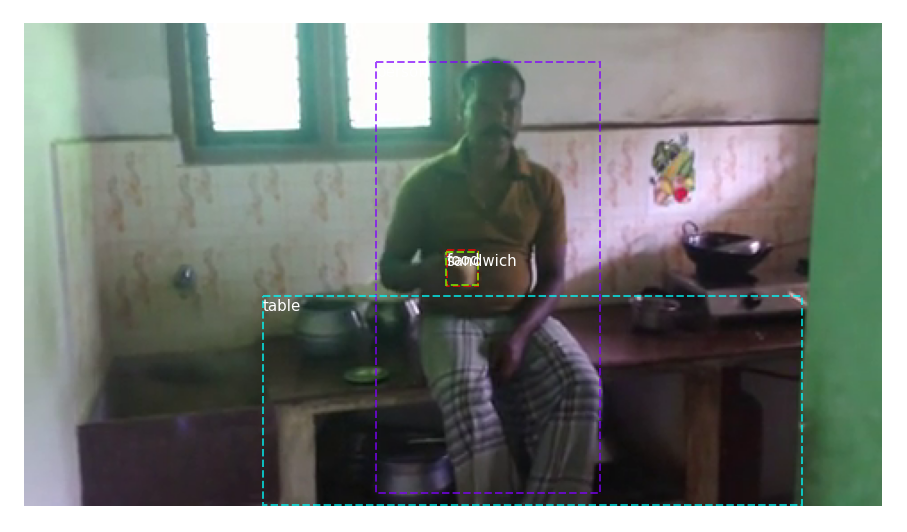

image height=270, width=480
predictions
Number of boxes:  258


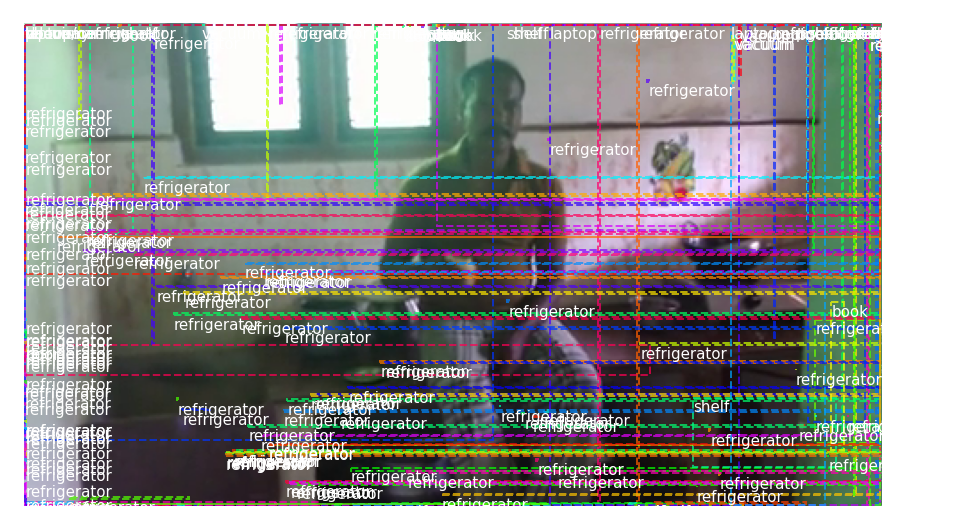

image height=270, width=480
gt
Number of boxes:  2


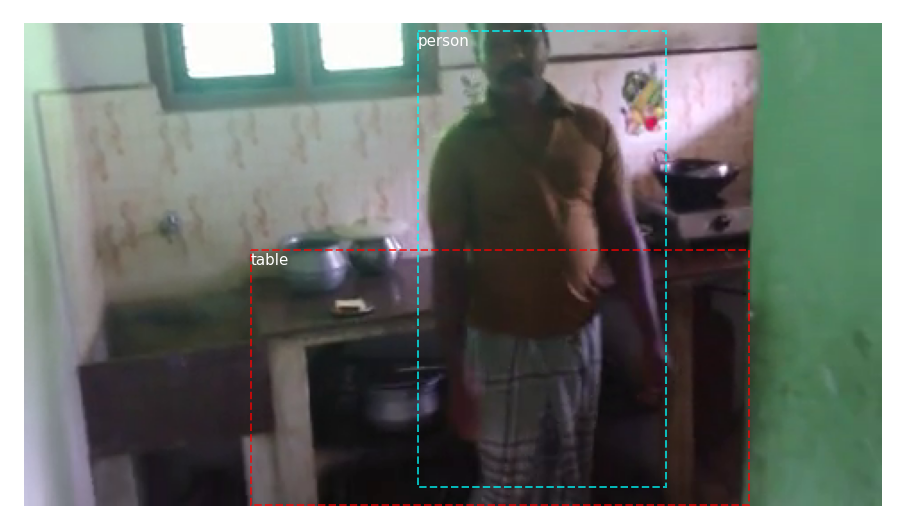

image height=270, width=480
predictions
Number of boxes:  256


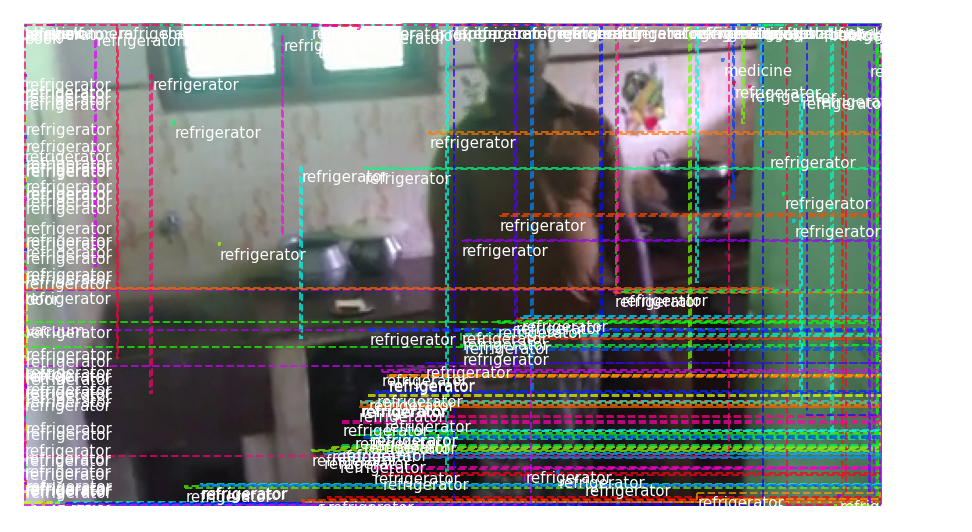

image height=270, width=480
gt
Number of boxes:  3


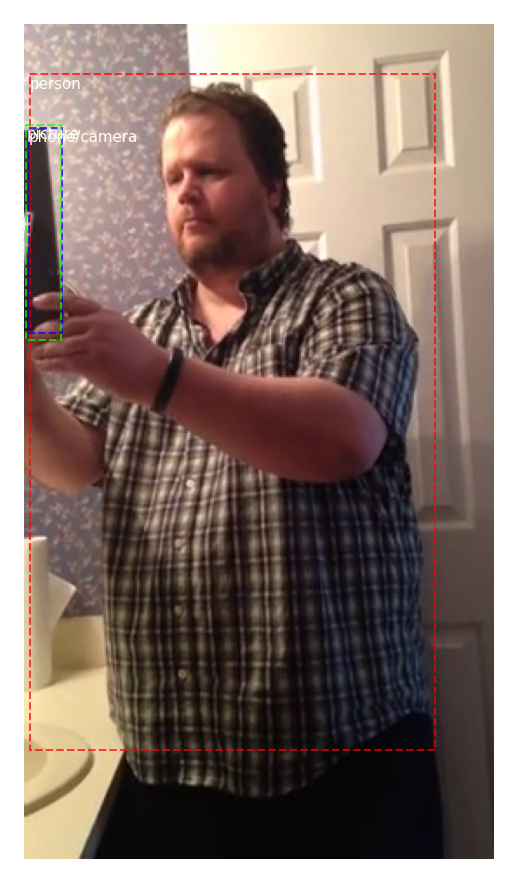

image height=480, width=270
predictions
Number of boxes:  256


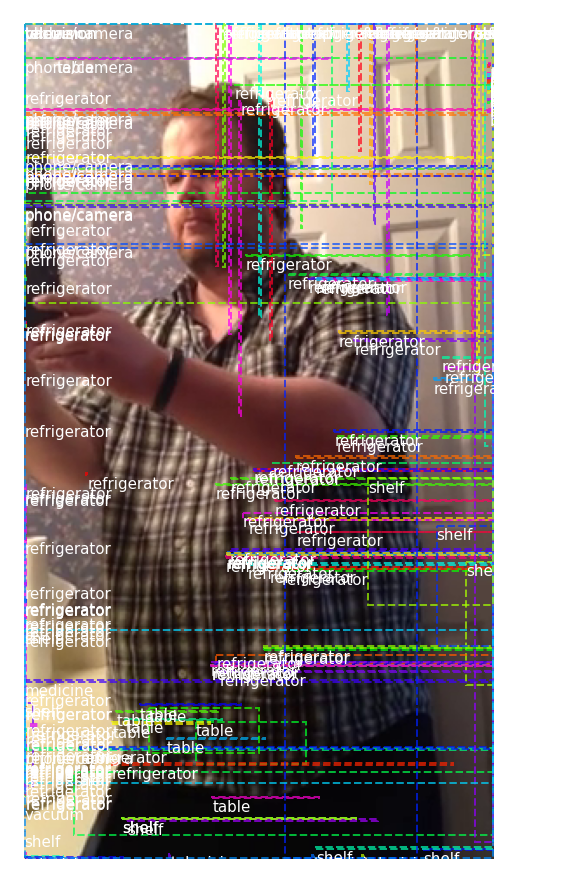

image height=480, width=270
gt
Number of boxes:  2


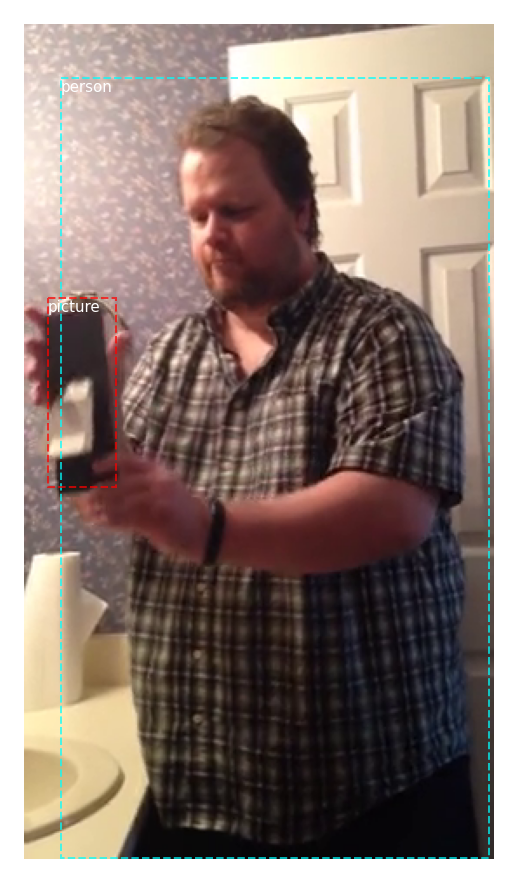

image height=480, width=270
predictions
Number of boxes:  268


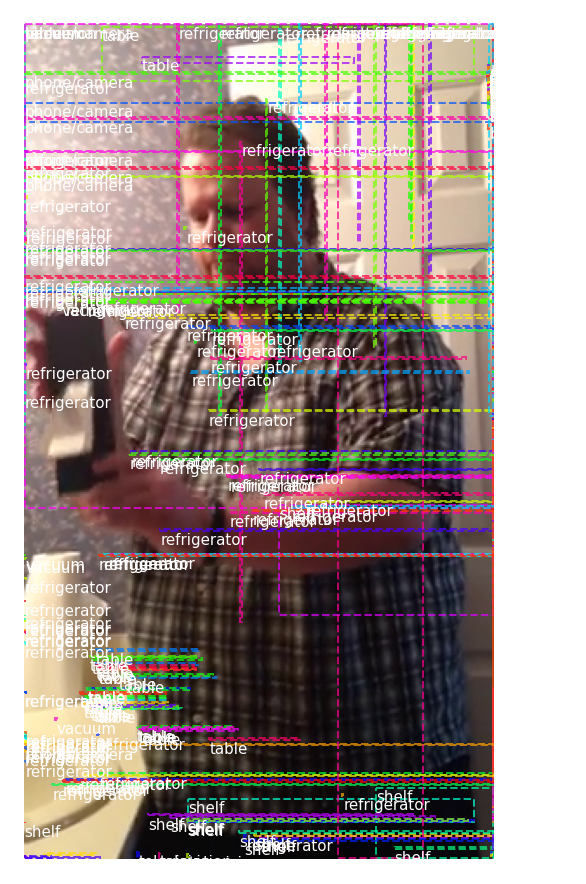

image height=480, width=270
gt
Number of boxes:  3


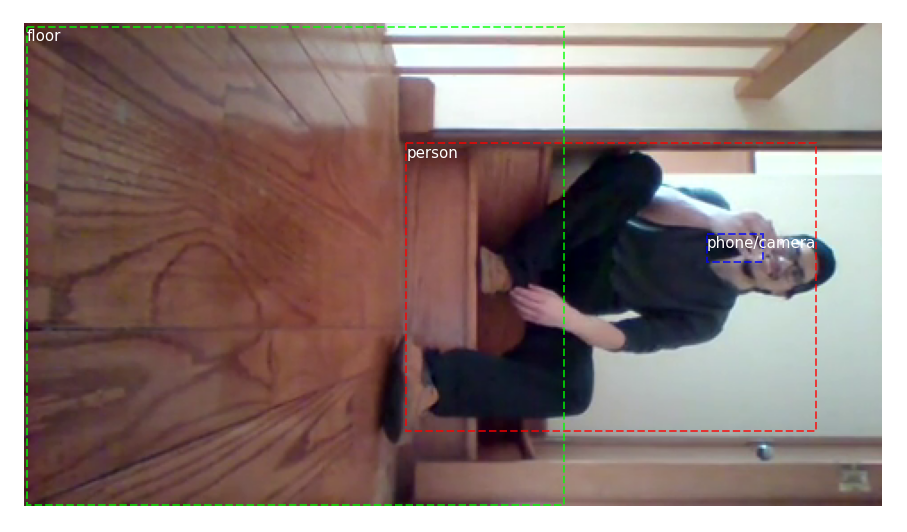

image height=270, width=480
predictions
Number of boxes:  328


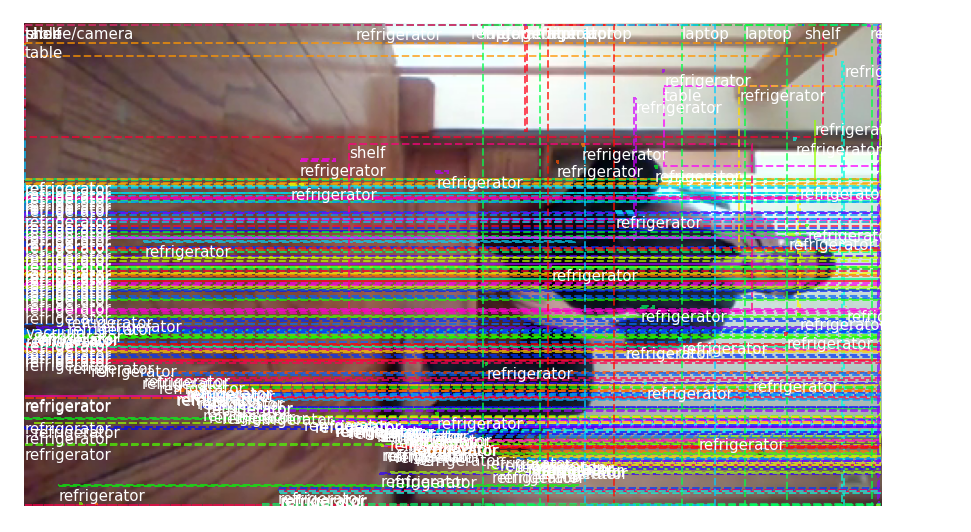

image height=270, width=480
gt
Number of boxes:  2


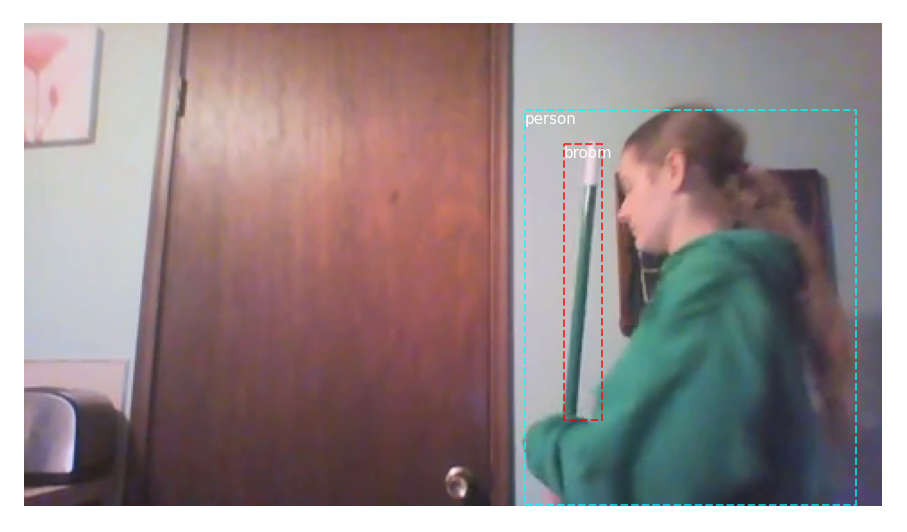

image height=270, width=480
predictions
Number of boxes:  256


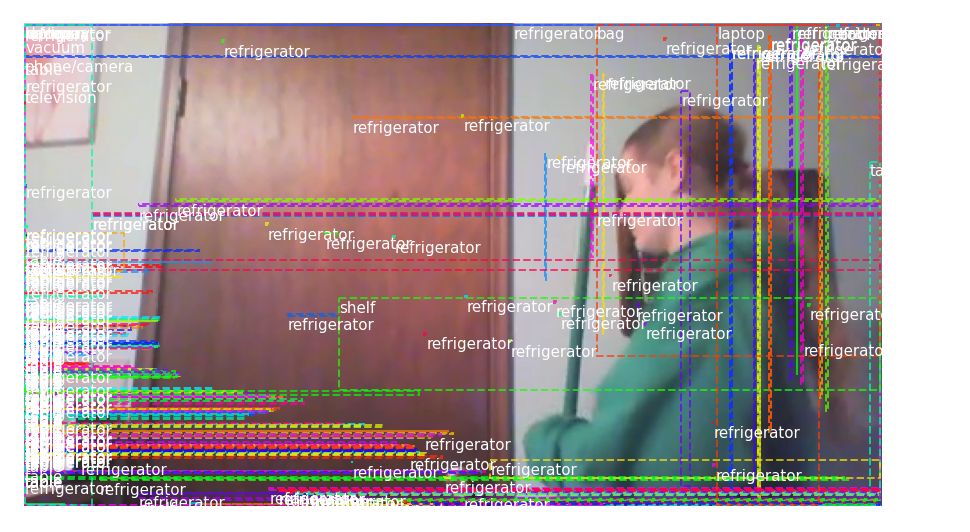

image height=270, width=480


In [28]:
for i, info in enumerate(infos):
    if i in [24, 56, 74, 92, 107, 127, 139, 146, 155, 183, 200]:
        image = Image.open(info['img_file']).convert("RGB")
        image = np.asarray(image, np.uint8)
        print('gt'); display_instances(image, info['groundtruth'])
        print('predictions'); display_instances(image, info['prediction'])
    else:
        continue
    # print(len(info['prediction']))

gt


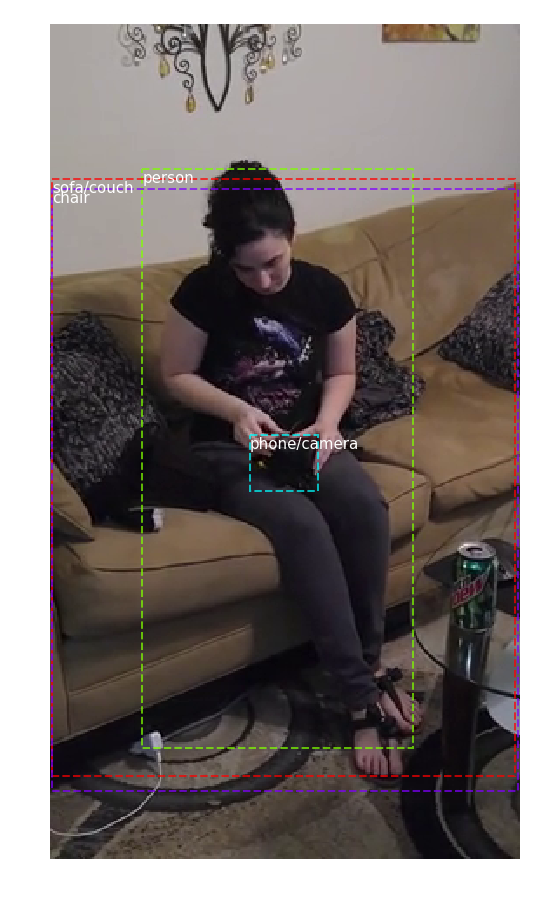

image height=480, width=270
predictions


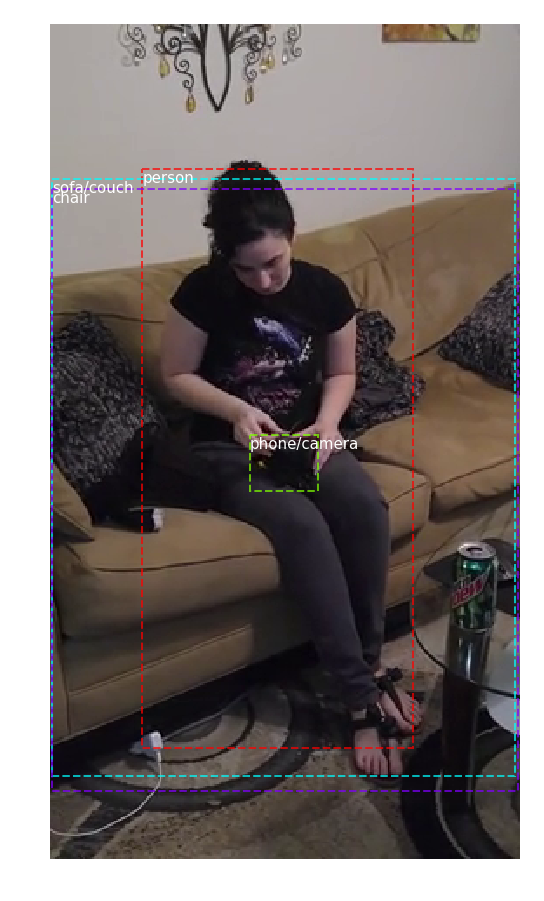

image height=480, width=270
gt


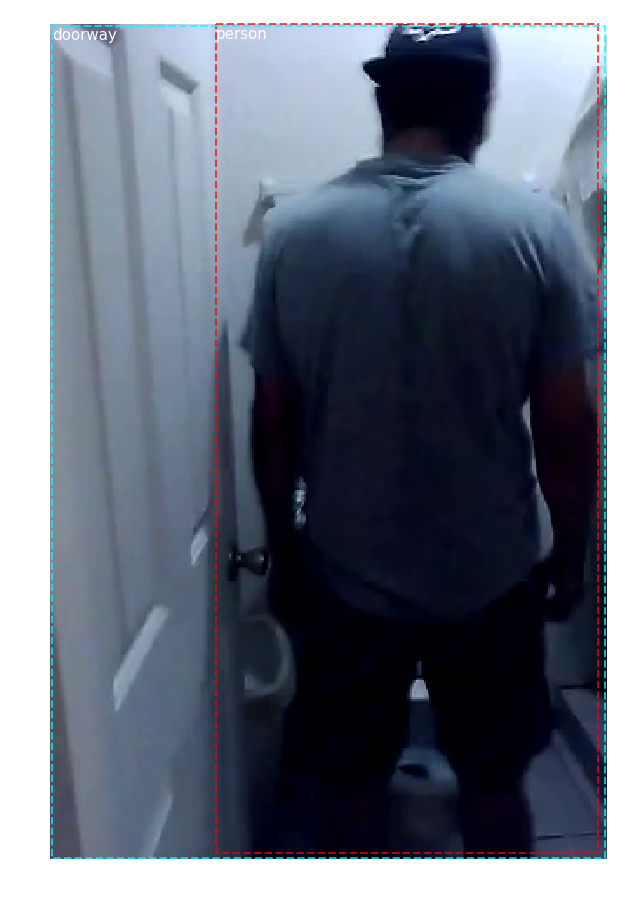

image height=480, width=320
predictions


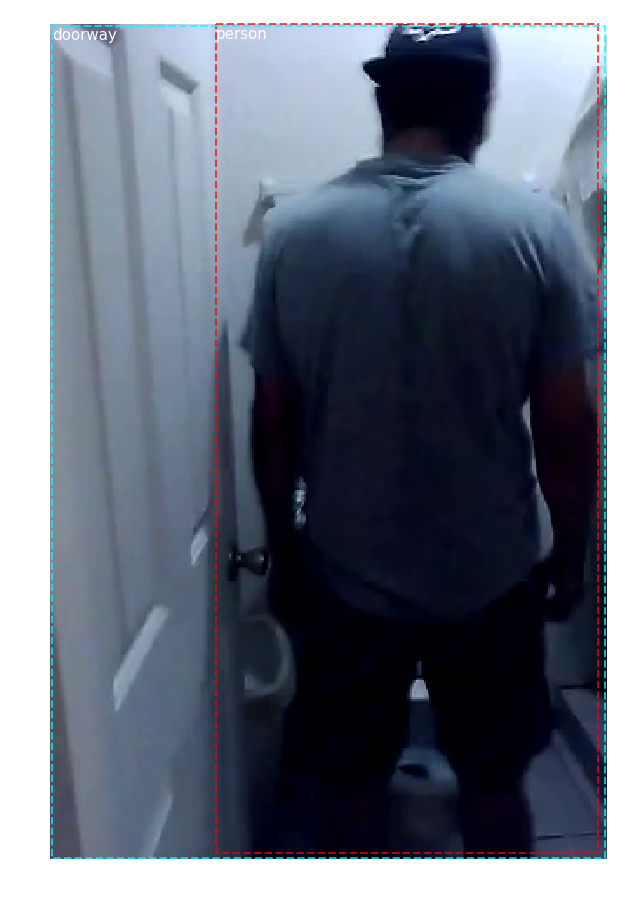

image height=480, width=320
gt


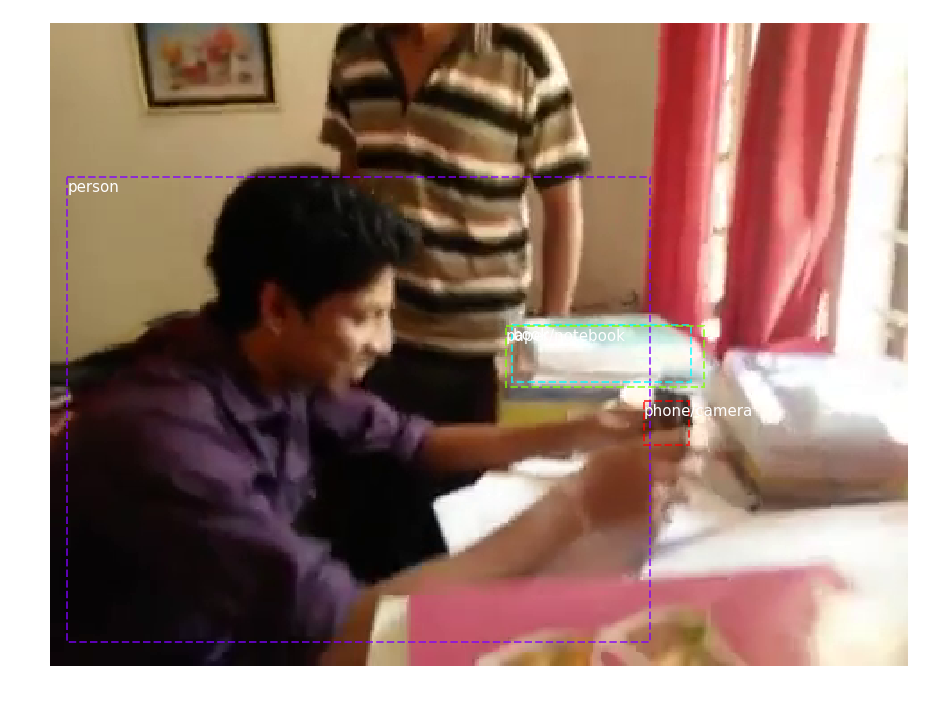

image height=360, width=480
predictions


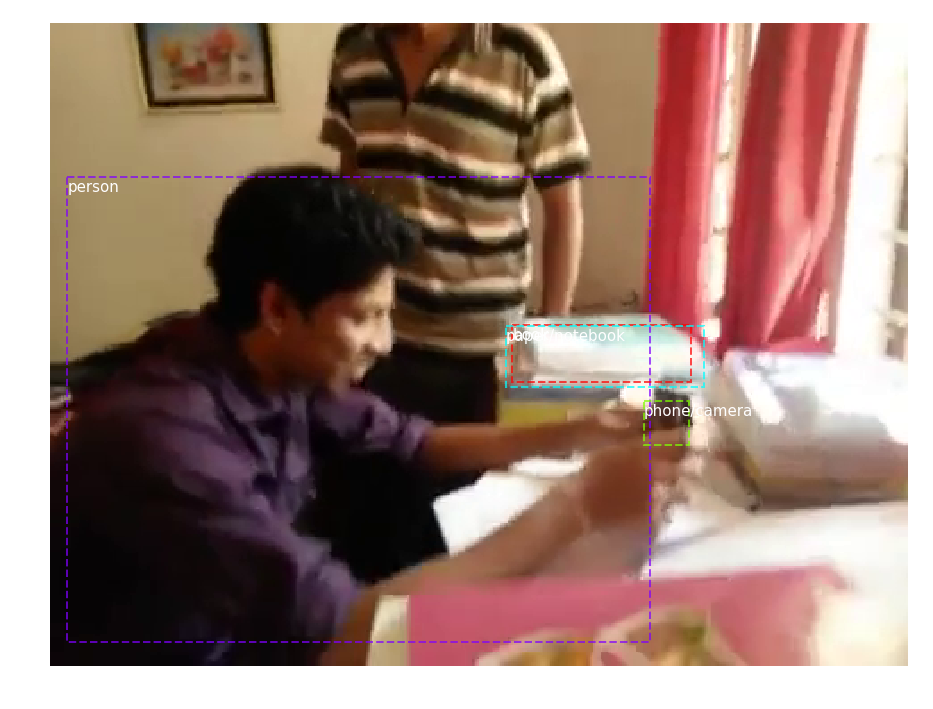

image height=360, width=480
gt


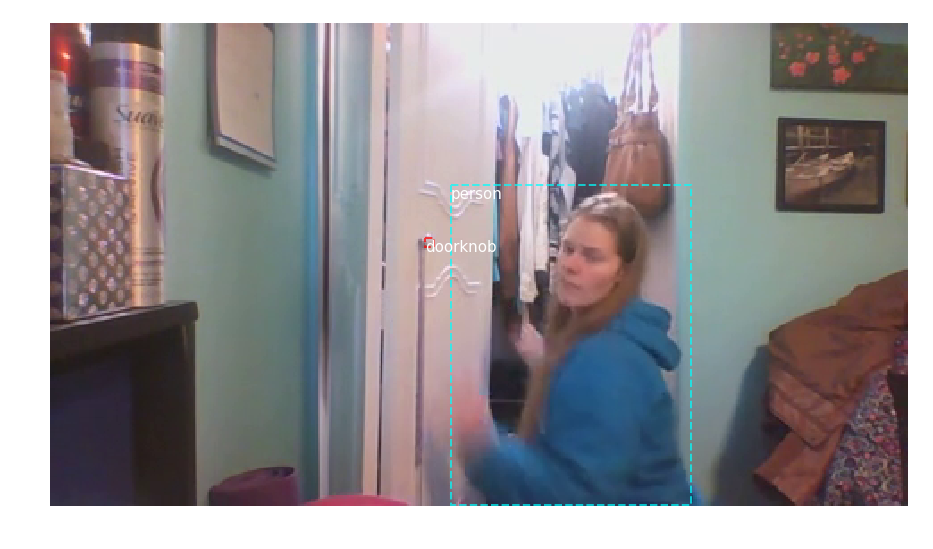

image height=270, width=480
predictions


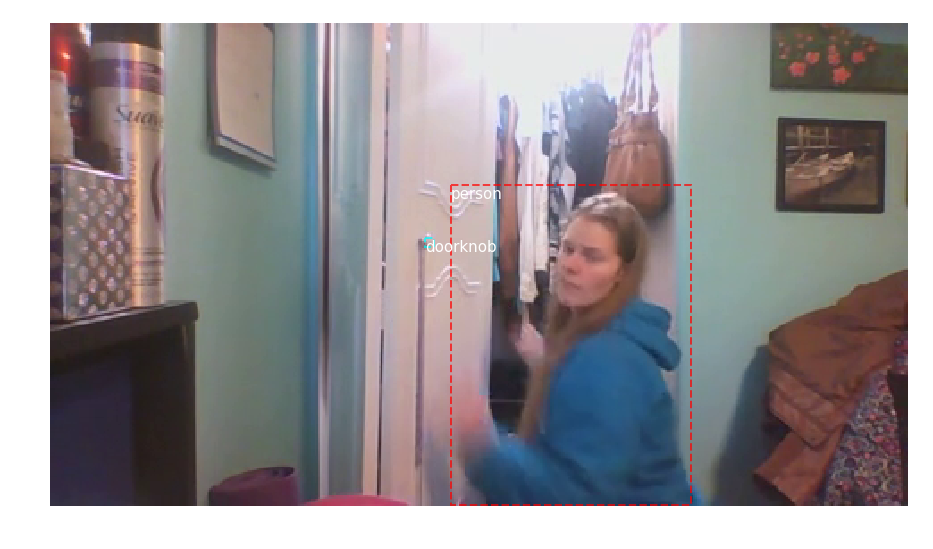

image height=270, width=480
gt


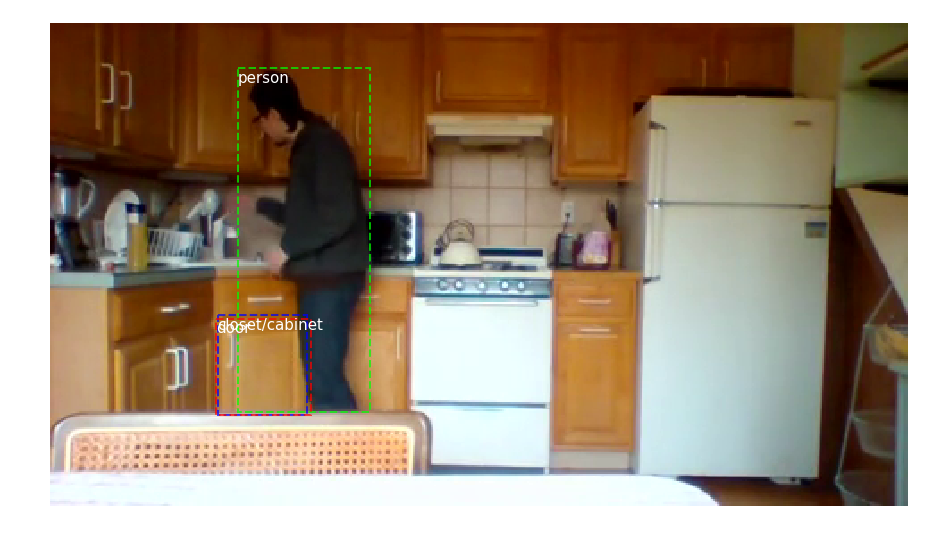

image height=270, width=480
predictions


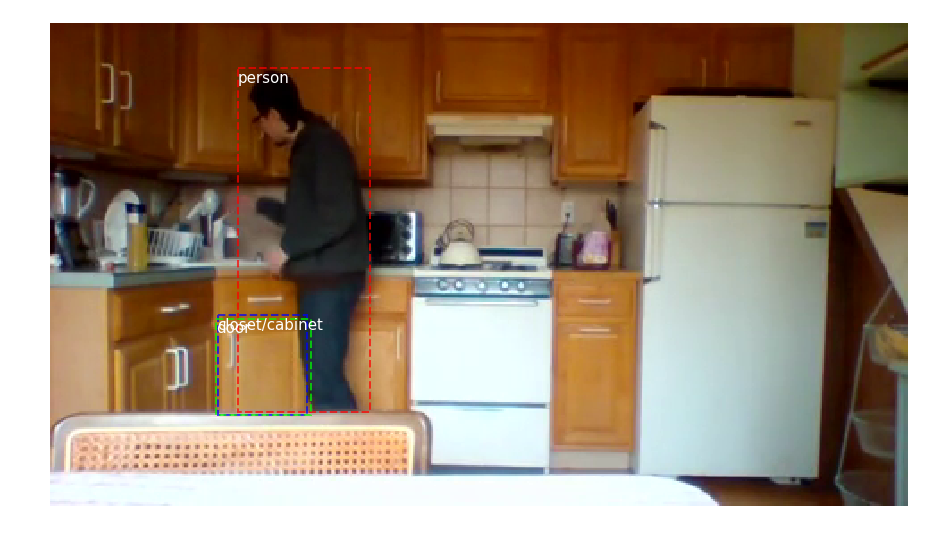

image height=270, width=480
gt


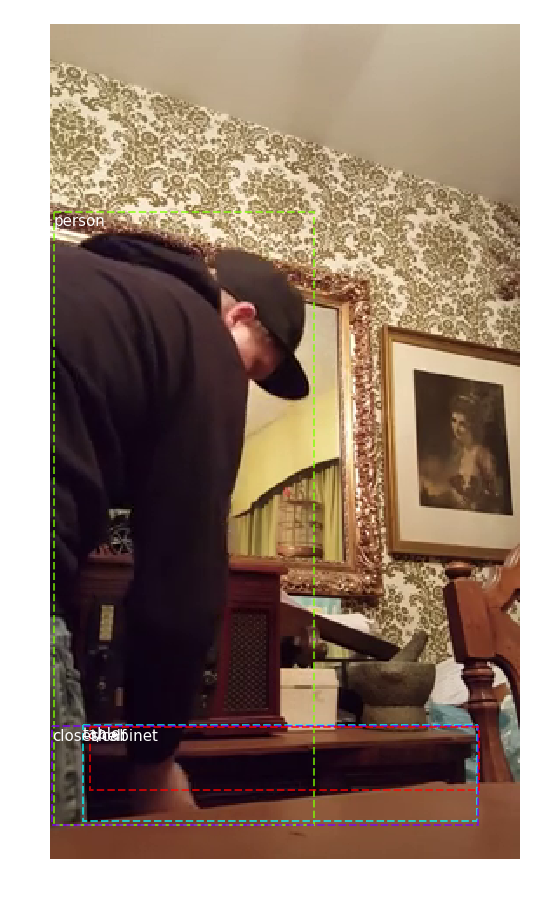

image height=480, width=270
predictions


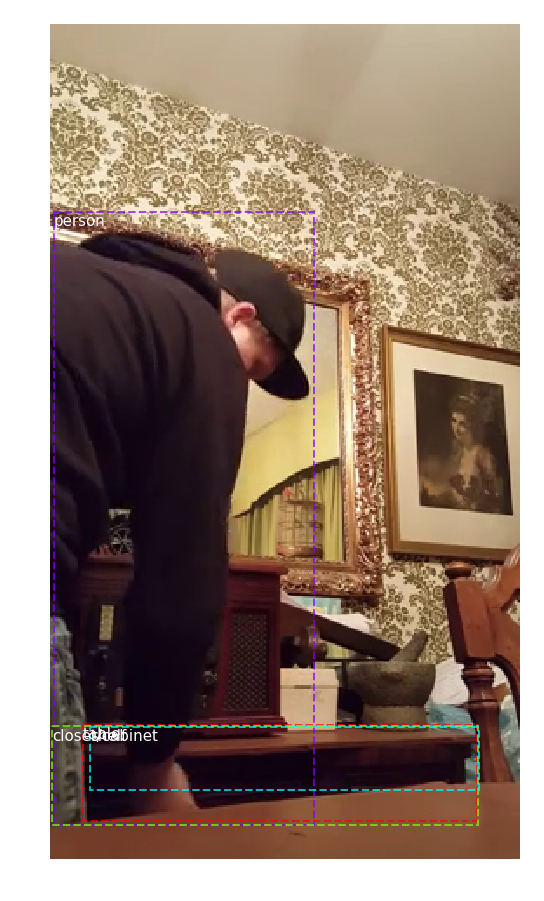

image height=480, width=270
gt


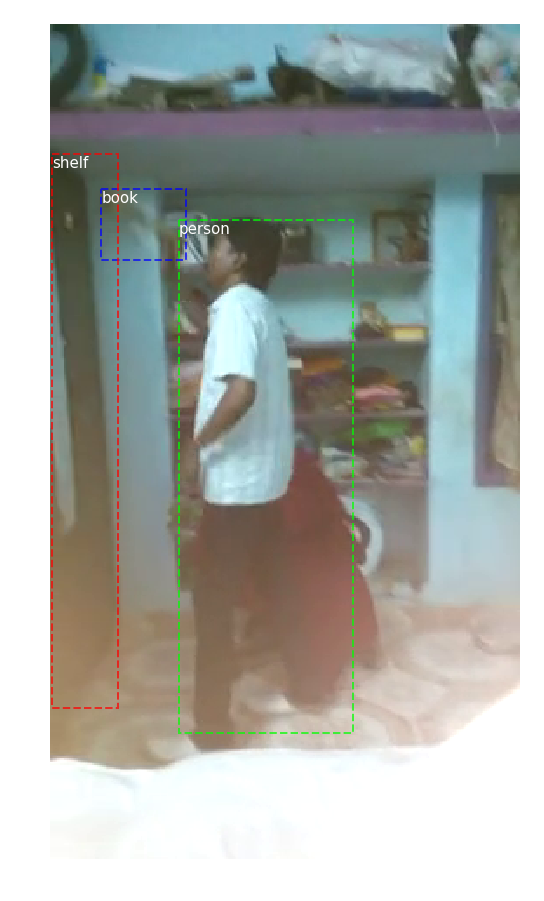

image height=480, width=270
predictions


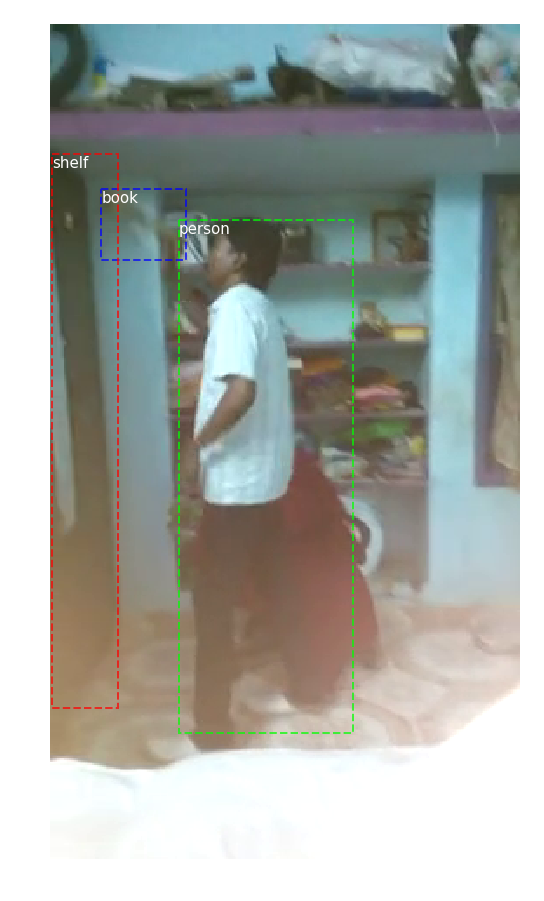

image height=480, width=270
gt


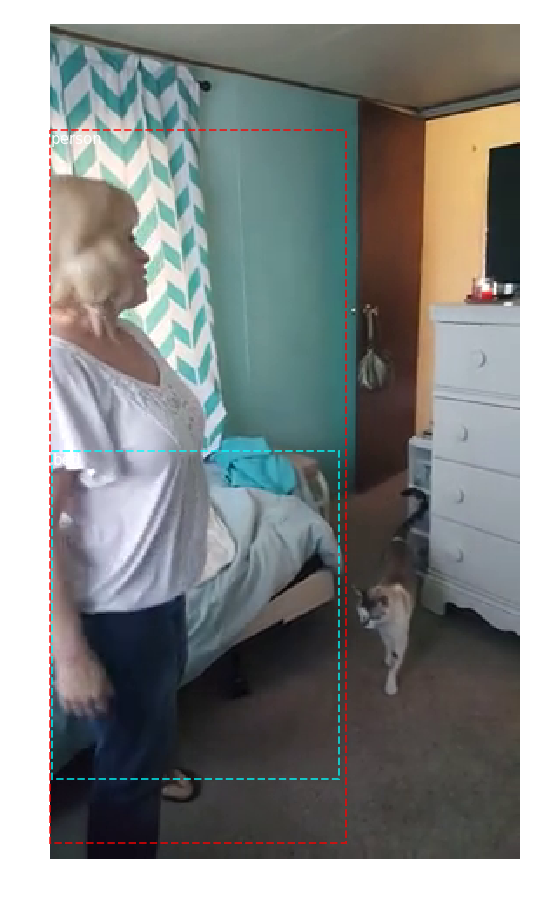

image height=480, width=270
predictions


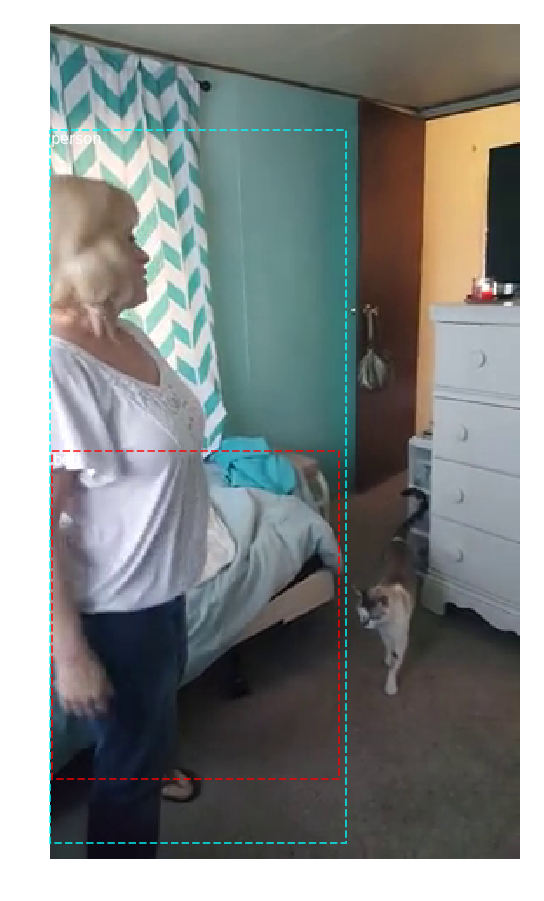

image height=480, width=270
gt


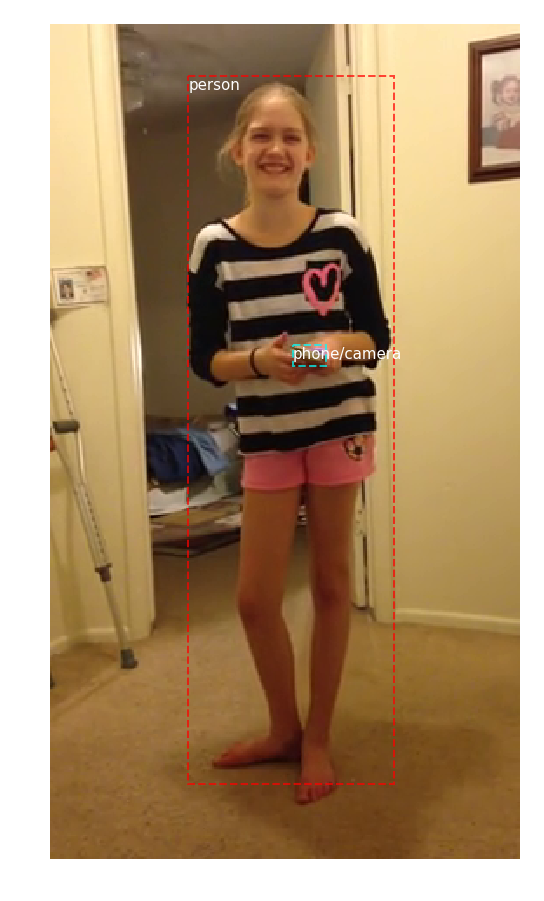

image height=480, width=270
predictions


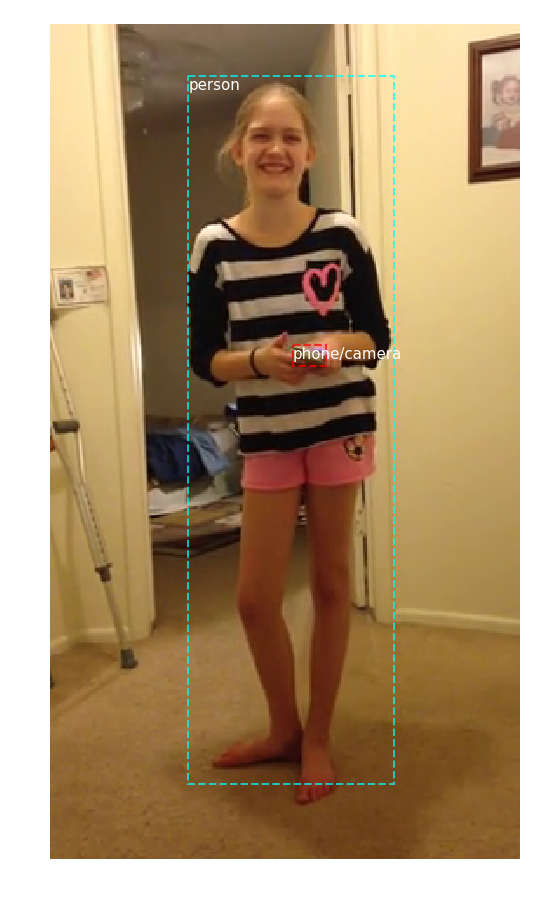

image height=480, width=270


In [10]:
for i, info in enumerate(infos):
    if i in [244, 369, 392, 450, 521, 601, 725, 856, 999]:
        image = Image.open(info['img_file']).convert("RGB")
        image = np.asarray(image, np.uint8)
        print('gt'); display_instances(image, info['groundtruth'])
        print('predictions'); display_instances(image, info['prediction'])
    else:
        continue
    # print(len(info['prediction']))